In [21]:
import json
import sys
from collections import Counter
from itertools import cycle
from pathlib import Path

import dabest
import matplotlib.pyplot as plt
import seaborn as sns
import mne
import numpy as np
import pandas as pd
import statsmodels.api as sm
import yaml

from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch
from mne_bids import BIDSPath
from mne_bids.read import read_raw_bids
from mne_bids.tsv_handler import _from_tsv
from ptitprince import PtitPrince as pt
from rerf.rerfClassifier import rerfClassifier
from scipy.io import loadmat
from scipy.spatial.distance import euclidean
from scipy import stats
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    auc, 
    accuracy_score, 
    cohen_kappa_score, 
    make_scorer, 
    plot_confusion_matrix, 
    roc_auc_score, 
    roc_curve
)
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, TimeSeriesSplit
from sklearn.preprocessing import MinMaxScaler, LabelBinarizer, label_binarize
from sklearn.utils import check_random_state
from tqdm import tqdm

src = "/Users/ChesterHuynh/OneDrive - Johns Hopkins/research/motor-decoding/"
if not src in sys.path:
    sys.path.append(src)

from mtsmorf.move_exp.cv import fit_classifiers_cv
from mtsmorf.move_exp.functions.move_experiment_functions import (
    get_event_data, 
    get_preprocessed_labels,
)
from mtsmorf.move_exp.functions.time_window_selection_functions import (
    bootstrap_independence_test,
    bootstrap_independence_test_OLS,
    bootstrap_independence_test_GLM,
    get_event_durations, 
    plot_event_onsets,
    plot_event_durations,
    plot_durations_by_label_raincloud,
    plot_durations_by_label_kde,
    plot_durations_cv_split,
)

if os.path.abspath("../io") not in sys.path:
    sys.path.append(os.path.abspath("../io"))

from mtsmorf.io.read import read_dataset, read_trial, get_trial_info
from mtsmorf.io.move.read import read_trial_metadata
from mtsmorf.io.utils import NumpyEncoder
from mtsmorf.move_exp.plotting import (
    plot_roc_multiclass_cv,
    plot_feature_importances,
    plot_cv_indices, 
    plot_classifier_performance,
    plot_roc_aucs,
    plot_accuracies,
)

# plt.style.use(['science', 'ieee', 'no-latex'])
plt.rcParams["font.family"] = "sans-serif"

%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
with open(Path(src) / "mtsmorf/move_exp/config.yml") as f:
    config = yaml.load(f, Loader=yaml.FullLoader)

with open(Path(src) / "mtsmorf/move_exp/metadata.yml") as f:
    metadata = yaml.load(f, Loader=yaml.FullLoader)

subjects = metadata["subjects"]

bids_root = Path(config["bids_root"])
results_path = Path(config["results_path"])

print(f"bids_root: {bids_root}")
print(f"results_path: {results_path}")

bids_root: /Volumes/Mac/research/data/efri
results_path: /Users/ChesterHuynh/OneDrive - Johns Hopkins/efri/derivatives/workstation_output/mtmorf


In [7]:
nfreqs = 10
lfreq, hfreq = (70, 200)
freqs = np.logspace(*np.log10([lfreq, hfreq]), num=nfreqs)
n_cycles = freqs / 3.0

rng = 1
n_splits = 5
cv = StratifiedKFold(n_splits)
metrics = dict(
    accuracy="accuracy",
    cohen_kappa_score=make_scorer(cohen_kappa_score),
    roc_auc_ovr="roc_auc_ovr",
)

label_names = {0: "Down", 1: "Right", 2: "Up", 3: "Left"}

## Event durations/onsets

/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

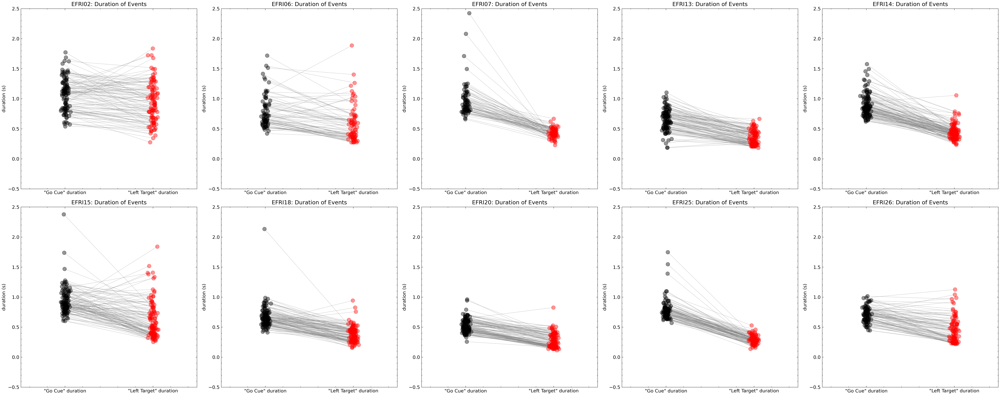

In [15]:
nrows = 2
ncols = 5
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, dpi=300, figsize=(6*ncols, 6*nrows))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    plot_event_durations(bids_path, ax=ax, random_state=rng)
fig.tight_layout();

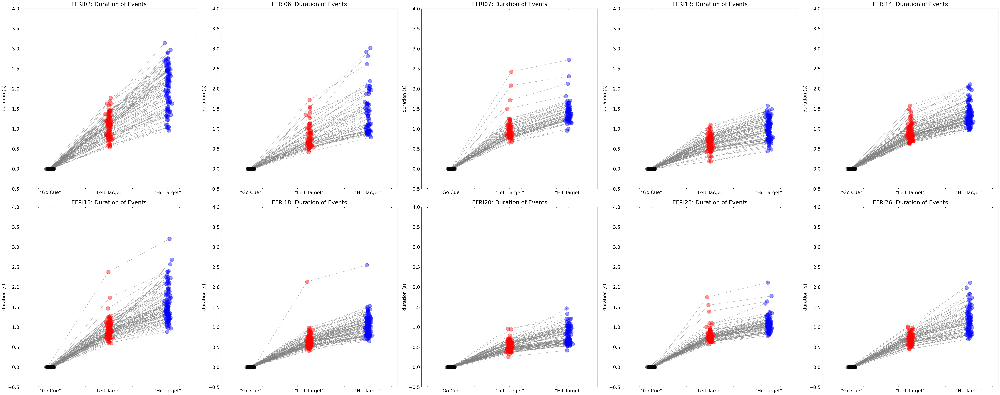

In [16]:
nrows = 2
ncols = 5
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, dpi=300, figsize=(6*ncols, 6*nrows))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    plot_event_onsets(bids_path, ax=ax, random_state=rng)

fig.tight_layout();

## Time durations grouped by label

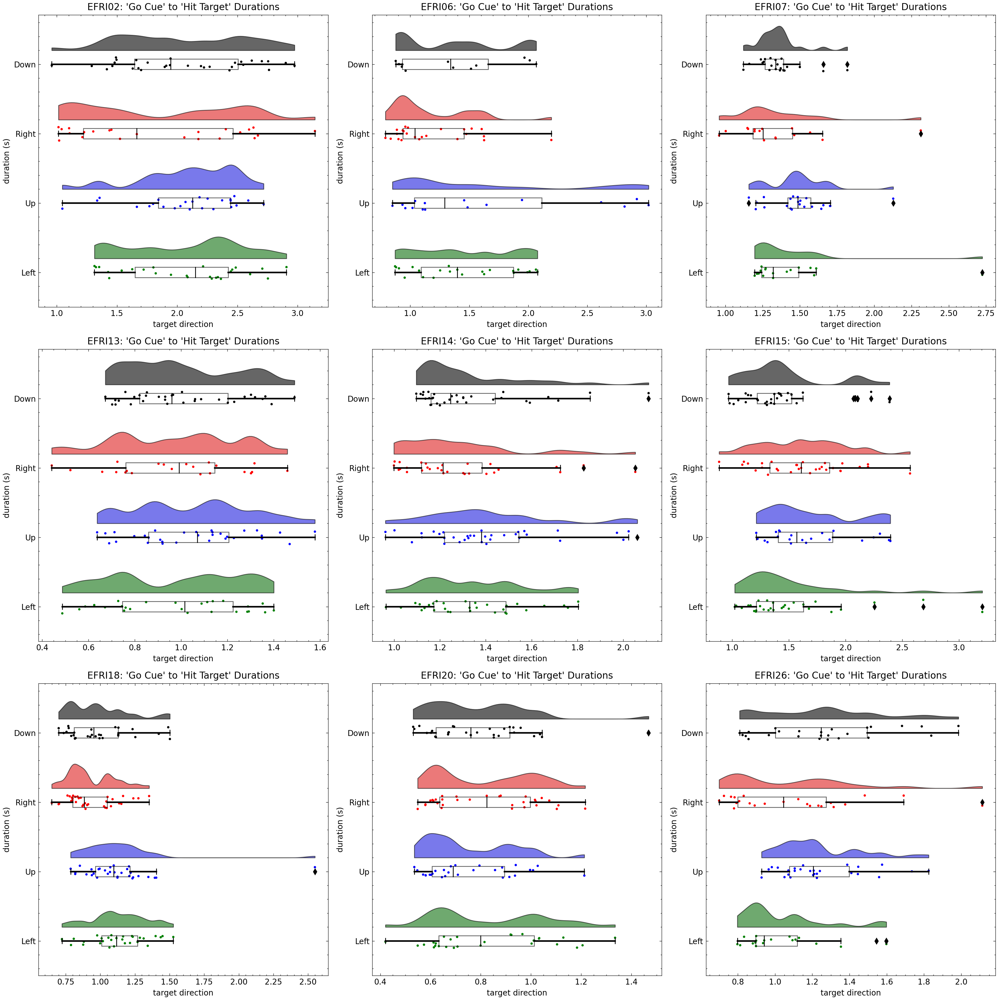

In [24]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=200, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    plot_durations_by_label_raincloud(bids_path, ax=ax)
fig.tight_layout();

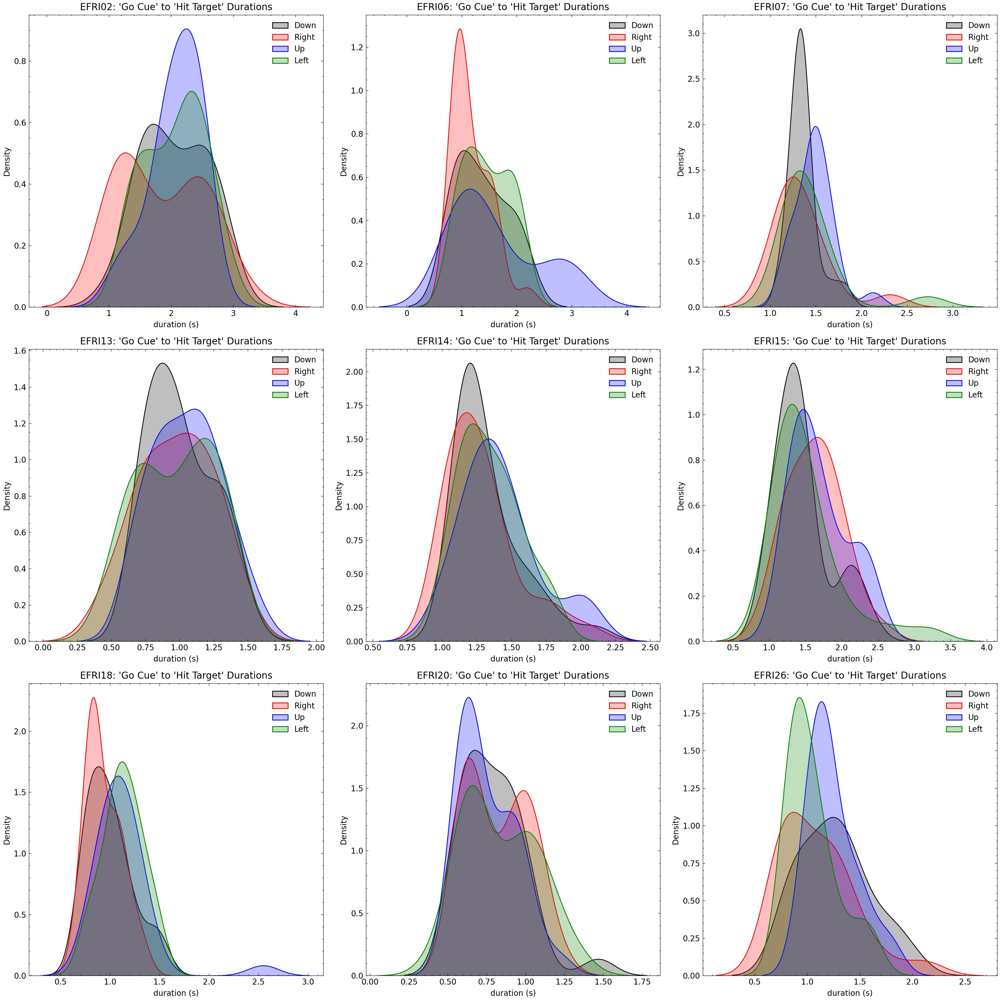

In [27]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=200, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    plot_durations_by_label_kde(bids_path, ax=ax)
fig.tight_layout();

Extracting parameters from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_events.tsv.
Reading channel info from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_channels.tsv.
Reading 0 ... 9875999  =      0.000 ...  4937.999 secs...
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 13201 samples (6.601 sec)

Used Annotations descriptions: ['At Center', 'False Start', 'Go Cue', 'Held Target', 'Hit Target', 'Leave Targ

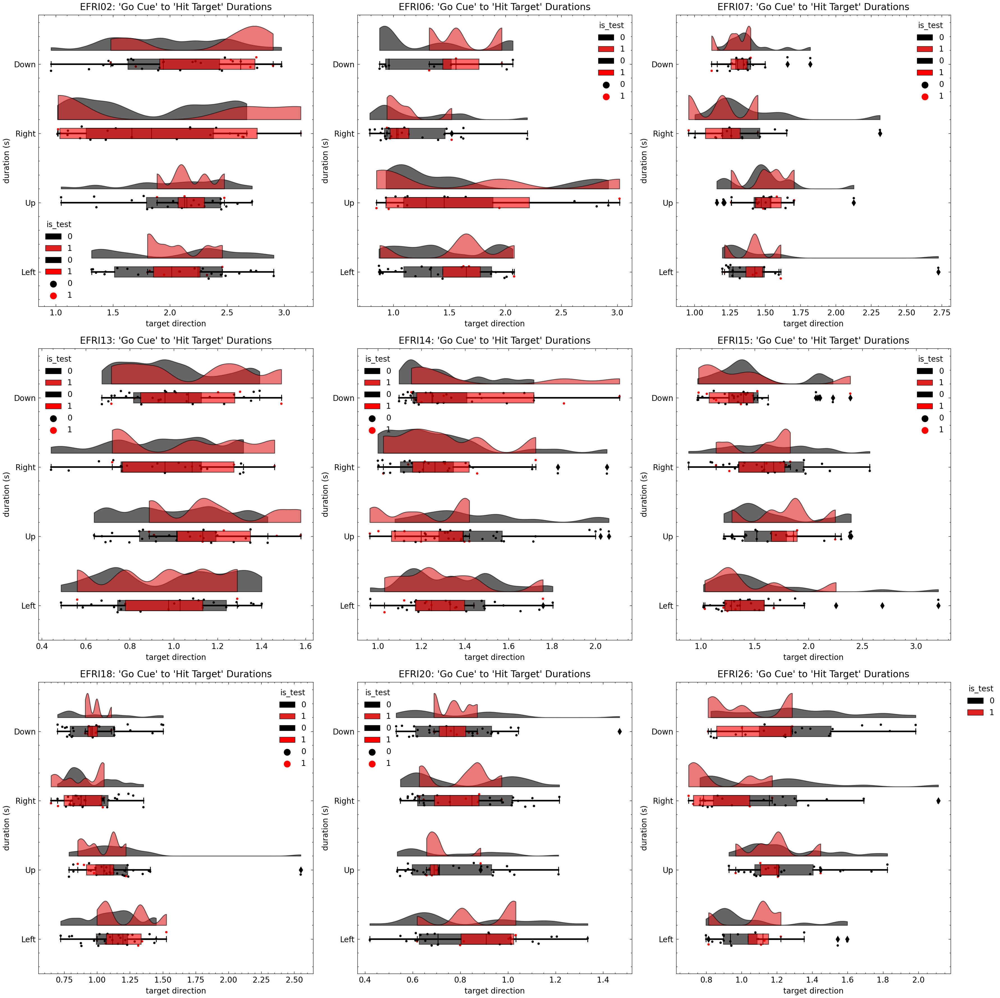

In [18]:
fig, axs = plt.subplots(nrows=3, ncols=3, dpi=200, figsize=(18, 18))
axs = axs.flatten()

for subject, ax in zip(subjects, axs):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    plot_durations_cv_split(bids_path, cv, ax=ax)

fig.tight_layout();

/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

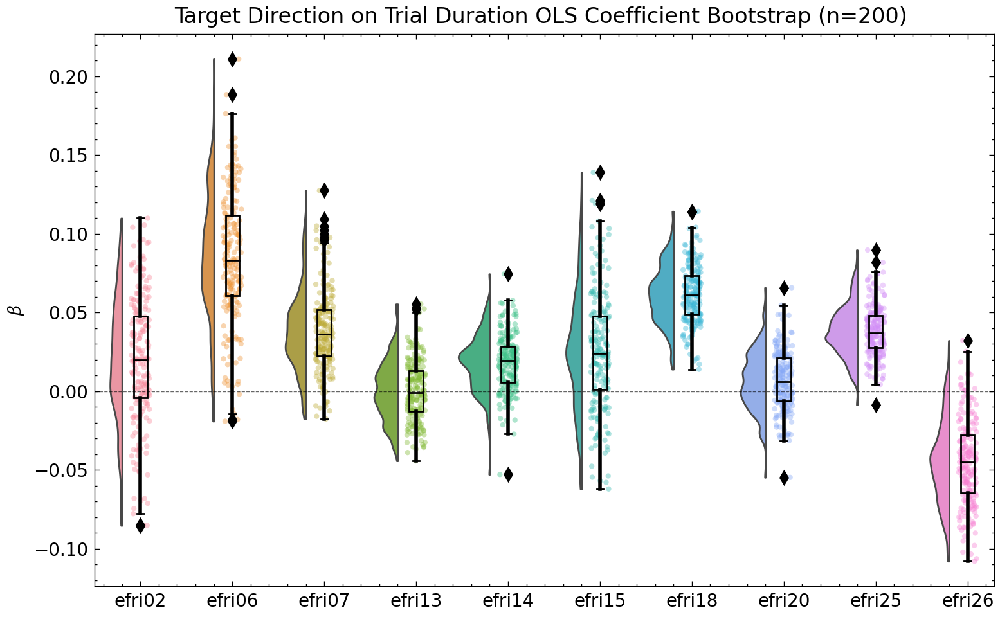

In [28]:
estimates_df = pd.DataFrame(columns=['estimates', 'subjects'])
num_bootstraps = 200
for i, subject in enumerate(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    # compute length of time window for go cue to hit target
    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)
    total_durations = go_cue_durations + left_target_durations

    trials = pd.DataFrame(read_trial_metadata(bids_root, subject))
    labels = trials[~(trials.perturbed) & (trials.success)].target_direction.values
    durations_df = pd.DataFrame(dict(durations=total_durations, labels=labels))

    # bootstrap estimate for regression coefficient between label and duration
    _, _, estimates = bootstrap_independence_test_OLS(
        X=durations_df.labels, y=durations_df.durations, num_bootstraps=num_bootstraps, random_state=rng
    )

    bootstrap_estimates = pd.DataFrame(dict(estimates=estimates, subjects=subject))
    estimates_df = estimates_df.append(bootstrap_estimates)

fig, ax = plt.subplots(dpi=200, figsize=(8, 5))

# plot regression coefficient estimates
pt.RainCloud(x="subjects", y="estimates", palette=None, data=estimates_df, cloud_alpha=.4, rain_alpha=0.4, ax=ax)
ax.axhline(y=0, lw=0.5, ls="--", alpha=0.6)
ax.set(
    title=f"Target Direction on Trial Duration OLS Coefficient Bootstrap (n={num_bootstraps}) ",
    xlabel="",
    ylabel=r"$\beta$",
)

fig.tight_layout();

/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

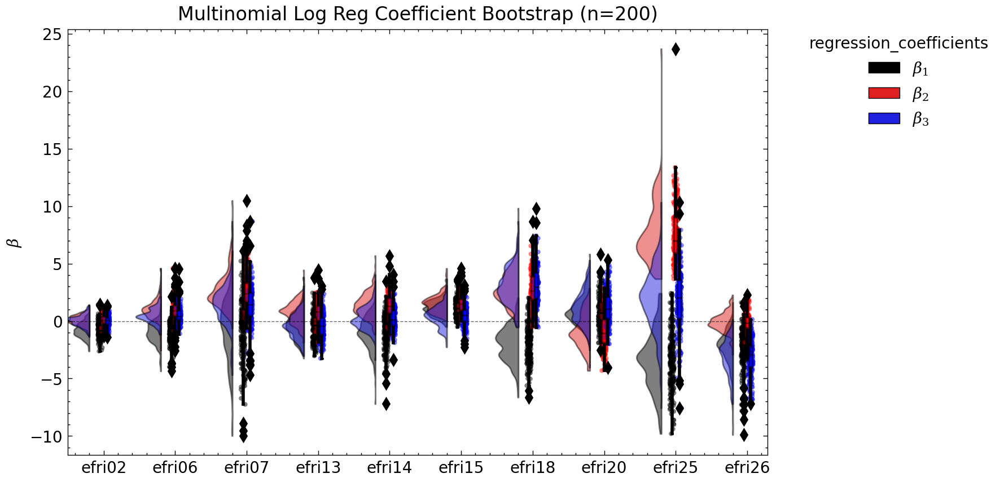

In [29]:
"""
Reference for interpreting multinomial log reg coefficients
https://stats.stackexchange.com/questions/116023/finding-multinomial-logit-regression-coefficients-in-r
"""

estimates_df = pd.DataFrame(columns=['subjects', 'target_directions', 'estimates'])
num_bootstraps = 200
for i, subject in enumerate(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    # compute length of time window for go cue to hit target
    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)
    total_durations = go_cue_durations + left_target_durations

    trials = pd.DataFrame(read_trial_metadata(bids_root, subject))
    labels = trials[~(trials.perturbed) & (trials.success)].target_direction.values
    durations_df = pd.DataFrame(dict(durations=total_durations, labels=labels))

    # bootstrap estimate for regression coefficient between label and duration
    _, _, estimates = bootstrap_independence_test(
        X=durations_df.durations, 
        y=durations_df.labels, 
        num_bootstraps=num_bootstraps, 
        random_state=rng
    )

    bootstrap_estimates = pd.DataFrame(
        [(i,j,k,subject) for i,j,k in estimates], 
        columns=[r'$\beta_1$', r'$\beta_2$', r'$\beta_3$', 'subjects']
    )
    bootstrap_estimates = pd.melt(
        bootstrap_estimates, 
        id_vars=["subjects"], 
        value_vars=[r'$\beta_1$', r'$\beta_2$', r'$\beta_3$'], 
        var_name ="regression_coefficients", value_name='estimates'
    )
    estimates_df = estimates_df.append(bootstrap_estimates)

fig, ax = plt.subplots(dpi=200, figsize=(8, 5))

# plot regression coefficient estimates
pt.RainCloud(
    x="subjects", y="estimates", hue="regression_coefficients", 
    palette=None, data=estimates_df, cloud_alpha=.5, rain_alpha=0.5, 
    alpha=0.5, dodge=True, ax=ax
)
ax.axhline(y=0, lw=0.5, ls="--", alpha=0.6)
ax.set(
    title=f"Multinomial Log Reg Coefficient Bootstrap (n={num_bootstraps})",
    xlabel="",
    ylabel=r"$\beta$",
);

/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
/opt/anaconda3/envs/motor-decoding/lib/python3.8/site-packages/pandas/core/frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

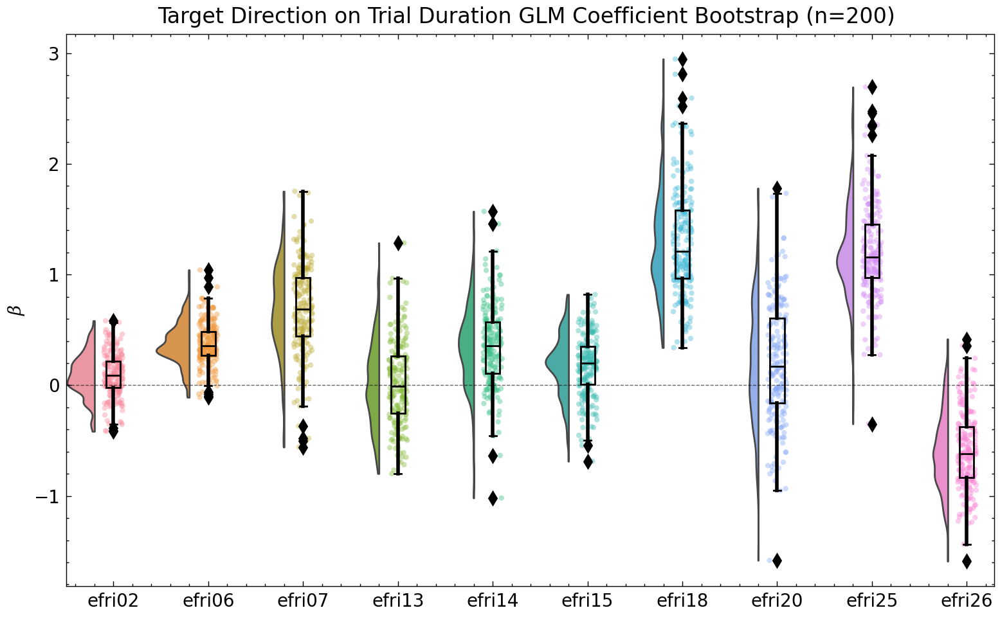

In [34]:
estimates_df = pd.DataFrame(columns=['estimates', 'subjects'])
num_bootstraps = 200
for i, subject in enumerate(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    # compute length of time window for go cue to hit target
    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)
    total_durations = go_cue_durations + left_target_durations

    trials = pd.DataFrame(read_trial_metadata(bids_root, subject))
    labels = trials[~(trials.perturbed) & (trials.success)].target_direction.values
    durations_df = pd.DataFrame(dict(durations=total_durations, labels=labels))

    # bootstrap estimate for regression coefficient between label and duration
    _, _, estimates = bootstrap_independence_test_GLM(
        X=durations_df.durations, y=durations_df.labels, num_bootstraps=num_bootstraps, random_state=rng
    )

    bootstrap_estimates = pd.DataFrame(dict(estimates=estimates, subjects=subject))
    estimates_df = estimates_df.append(bootstrap_estimates)

fig, ax = plt.subplots(dpi=200, figsize=(8, 5))

# plot regression coefficient estimates
pt.RainCloud(x="subjects", y="estimates", palette=None, data=estimates_df, cloud_alpha=.4, rain_alpha=0.4, ax=ax)
ax.axhline(y=0, lw=0.5, ls="--", alpha=0.6)
ax.set(
    title=f"Target Direction on Trial Duration GLM Coefficient Bootstrap (n={num_bootstraps}) ",
    xlabel="",
    ylabel=r"$\beta$",
)

fig.tight_layout();

## Globally shortest time window

In [29]:
def get_shortest_event_durations(bids_root, subjects, label_keyword="Left Target"):
    before_duration = np.inf
    after_duration = np.inf
    for subject in subjects:
        path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
        bids_path = BIDSPath(**path_identifiers)

        go_cue_duration = get_event_durations(bids_path, event_key="Left Target", periods=-1)
        left_target_duration = get_event_durations(bids_path, event_key="Left Target", periods=1)

        # update durations if one of the durations for this patient is shorter
        before_duration = min(before_duration, min(go_cue_duration))
        after_duration = min(after_duration, min(left_target_duration))
    
    return before_duration, after_duration

In [30]:
before_duration, after_duration = get_shortest_event_durations(bids_root, subjects)

tmin = -before_duration
tmax = after_duration
print(tmin, tmax)

-0.1150000000000091 0.18650000000002365


In [31]:
data = dict()
subject_clf_scores = dict()

for subject in tqdm(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data[subject] = (X, y)

    subject_clf_scores[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

  0%|          | 0/9 [00:00<?, ?it/s]Extracting parameters from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_events.tsv.
Reading channel info from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_channels.tsv.
Reading 0 ... 9875999  =      0.000 ...  4937.999 secs...
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 13201 samples (6.601 sec)

Used Annotations descriptions: ['At Center', 'False Start', 'Go Cue', 'He

In [ ]:
for subject, clf_scores in subject_clf_scores.items():

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    
    # 1. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[0].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )
    
    # 2. Plot ROC AUCs
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )

    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

In [ ]:
for subject, clf_scores in subject_clf_scores.items():

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

## Using patient-specific time-windows

## Shortest window

**Quality of results**
- Both markedly non-trivial: efri07,  efri20,
- Both barely non-trivial: efri14, efri15, efri26
- One clf is trivial: efri02, efri13
- Both MT-MORF or S-ReRF is trivial: efri06, efri18

In [18]:
def get_shortest_event_durations_by_patient(bids_root, subjects, label_keyword="Left Target"):
    durations = dict()
    for subject in subjects:
        path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
        bids_path = BIDSPath(**path_identifiers)

        go_cue_duration = get_event_durations(bids_path, event_key="Left Target", periods=-1)
        left_target_duration = get_event_durations(bids_path, event_key="Left Target", periods=1)

        # update durations
        before_duration = min(go_cue_duration)
        after_duration = min(left_target_duration)
        durations[subject] = (before_duration, after_duration)
    
    return durations

In [19]:
durations = get_shortest_event_durations_by_patient(bids_root, subjects)
durations

Out of 135 trials, there were 132 successful trials in /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 97 trials, there were 94 successful trials in /Volumes/Mac/research/data/efri/sub-efri06/ses-efri/ieeg/sub-efri06_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 98 trials, there were 96 successful trials in /Volumes/Mac/research/data/efri/sub-efri07/ses-efri/ieeg/sub-efri07_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 155 trials, there were 143 successful trials in /Volumes/Mac/research/data/efri/sub-efri13/ses-efri/ieeg/sub-efri13_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 163 trials, there were 154 successful trials in /Volumes/Mac/research/data/efri/sub-efri14/ses-efri/ieeg/sub-efri14_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr.
Out of 144 trials, there were 139 successful trials in /Volumes/Mac/research/data/efri/sub-efri15/ses-efri/ieeg/sub-efri15_ses-efri_task-move_acq-seeg_run-01_i

{'efri02': (0.27599999999983993, 0.5410000000001673),
 'efri06': (0.27499999999997726, 0.4214999999999236),
 'efri07': (0.2300000000000182, 0.6589999999999918),
 'efri13': (0.18399999999996908, 0.18650000000002365),
 'efri14': (0.2339999999999236, 0.6205000000001064),
 'efri15': (0.25299999999992906, 0.6025000000000205),
 'efri18': (0.16049999999995634, 0.4134999999998854),
 'efri20': (0.1150000000000091, 0.2595000000001164),
 'efri26': (0.2179999999998472, 0.4470000000001164)}

In [ ]:
data2 = dict()
subject_clf_scores2 = dict()

for subject in tqdm(subjects):
    ## Get patient specific windows
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data2[subject] = (X, y)

    subject_clf_scores2[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores2.items()):

    destination = results_path / subject

    X, y = data2[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    # 1. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[0].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    
    # 2. Plot ROC AUCs
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores.items()):

    destination = results_path / subject

    X, y = data[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Shortest Patient-Specific Time Window",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

### Median window

In [88]:
def get_median_event_durations_by_patient(bids_root, subjects, label_keyword="Left Target"):
    durations = dict()
    for subject in subjects:
        path_identifiers = dict(subject=subject, session="efri", task="move", 
                            acquisition="seeg", run="01", suffix="ieeg", 
                            extension=".vhdr", root=bids_root)
        bids_path = BIDSPath(**path_identifiers)

        go_cue_duration = get_event_durations(bids_path, event_key="Left Target", periods=-1)
        left_target_duration = get_event_durations(bids_path, event_key="Left Target", periods=1)

        # update durations
        before_duration = np.median(go_cue_duration)
        after_duration = np.median(left_target_duration)
        durations[subject] = (before_duration, after_duration)
    
    return durations

In [ ]:
durations = get_median_event_durations_by_patient(bids_root, subjects)
durations

In [ ]:
data3 = dict()
subject_clf_scores3 = dict()

for subject in tqdm(subjects):
    ## Get patient specific windows
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".vhdr",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.25, tmax=tmax+0.25)

    power = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, average=False, return_itc=False, decim=3, n_jobs=-1)
    power.crop(tmin=tmin, tmax=tmax)

    power_data = power.data
    ntrials, nchs, nfreqs, nsteps = power_data.shape
    print(ntrials, nchs, nfreqs, nsteps)
    image_height = nchs * nfreqs
    image_width = nsteps

    X = power_data.reshape(ntrials, -1)
    y = labels

    data3[subject] = (X, y)

    subject_clf_scores3[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores3.items()):

    destination = results_path / subject

    X, y = data3[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(ncols=2, dpi=100, figsize=(16, 6))
    axs = axs.flatten()
    # 1. Plot accuracies
    plot_accuracies(clf_scores, ax=axs[1])
    axs[0].set(
        ylabel="accuracy",
        title=f"{subject.upper()}: Accuracies for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )
    
    # 2. Plot ROC AUCs
    plot_roc_aucs(clf_scores, ax=axs[0])
    axs[1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Patient-Specific Time Window {tmin:.3f}-{tmax:.3f}",
    )

    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_freq_domain.png")

In [ ]:
for subject, clf_scores in tqdm(subject_clf_scores3.items()):

    destination = results_path / subject

    X, y = data3[subject]
    before_duration, after_duration = durations[subject]
    tmin = -before_duration
    tmax = after_duration

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Median Patient-Specific Time Window",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_patient_specific_time_window_tmin={tmin:.3f}_tmax={tmax:.3f}_rocs_freq_domain.png")

### Trial-specific time windows (zero-padding) -- Time Domain

In [4]:
data4 = dict()
subject_clf_scores4 = dict()
for subject in tqdm(subjects):
    path_identifiers = dict(subject=subject, session="efri", task="move", 
                        acquisition="seeg", run="01", suffix="ieeg", 
                        extension=".vhdr", root=bids_root)
    bids_path = BIDSPath(**path_identifiers)

    go_cue_durations = get_event_durations(bids_path, event_key="Left Target", periods=-1)
    left_target_durations = get_event_durations(bids_path, event_key="Left Target", periods=1)

    tmin = -max(go_cue_durations)
    tmax = max(left_target_durations)
    
    epochs, labels = get_event_data(bids_path, tmin=tmin-0.2, tmax=tmax+0.2)
    epochs_data = epochs.get_data()
    data4[subject] = (epochs_data, labels)
    
    ntrials, nchs, nsteps = epochs_data.shape
    print(f"{subject.upper()}: epochs_data.shape = ({epochs_data.shape})")

    t = epochs.times
    mask = (t >= -np.asarray(go_cue_durations)[:, None, None]) \
            & (t <= np.asarray(left_target_durations)[:, None, None])

    masked_data = epochs_data * mask

    X = masked_data.reshape(ntrials, -1)
    y = labels

    image_height = nchs
    image_width = nsteps

    subject_clf_scores4[subject] = fit_classifiers_cv(X, y, image_height, image_width, cv, metrics, random_state=rng)

  0%|          | 0/9 [00:00<?, ?it/s]Extracting parameters from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_events.tsv.
Reading channel info from /Volumes/Mac/research/data/efri/sub-efri02/ses-efri/ieeg/sub-efri02_ses-efri_task-move_acq-seeg_run-01_channels.tsv.
Reading 0 ... 9875999  =      0.000 ...  4937.999 secs...
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 13201 samples (6.601 sec)

Used Annotations descriptions: ['At Center', 'False Start', 'Go Cue', 'He

In [7]:
import json
for subject, cv_scores in subject_clf_scores4.items():
    for clf_name, clf_scores in cv_scores.items():
        estimator = clf_scores['estimator']
        if estimator is not None:
            del clf_scores['estimator']

        fpath = results_path / f"{subject}/trial_specific_window/time_domain/"
        if not os.path.exists(fpath):
            os.makedirs(fpath)
        with open(fpath / f"{subject}_{clf_name}_results.json", "w") as fout:
            json.dump(clf_scores, fout, cls=NumpyEncoder)
            print(f"{subject.upper()} CV results for {clf_name} saved as json.")
        clf_scores['estimator'] = estimator

EFRI02 CV results for MT-MORF saved as json.
EFRI02 CV results for S-RerF saved as json.
EFRI02 CV results for LogisticRegression saved as json.
EFRI02 CV results for RandomForestClassifier saved as json.
EFRI02 CV results for most_frequent saved as json.
EFRI06 CV results for MT-MORF saved as json.
EFRI06 CV results for S-RerF saved as json.
EFRI06 CV results for LogisticRegression saved as json.
EFRI06 CV results for RandomForestClassifier saved as json.
EFRI06 CV results for most_frequent saved as json.
EFRI07 CV results for MT-MORF saved as json.
EFRI07 CV results for S-RerF saved as json.
EFRI07 CV results for LogisticRegression saved as json.
EFRI07 CV results for RandomForestClassifier saved as json.
EFRI07 CV results for most_frequent saved as json.
EFRI13 CV results for MT-MORF saved as json.
EFRI13 CV results for S-RerF saved as json.
EFRI13 CV results for LogisticRegression saved as json.
EFRI13 CV results for RandomForestClassifier saved as json.
EFRI13 CV results for most_

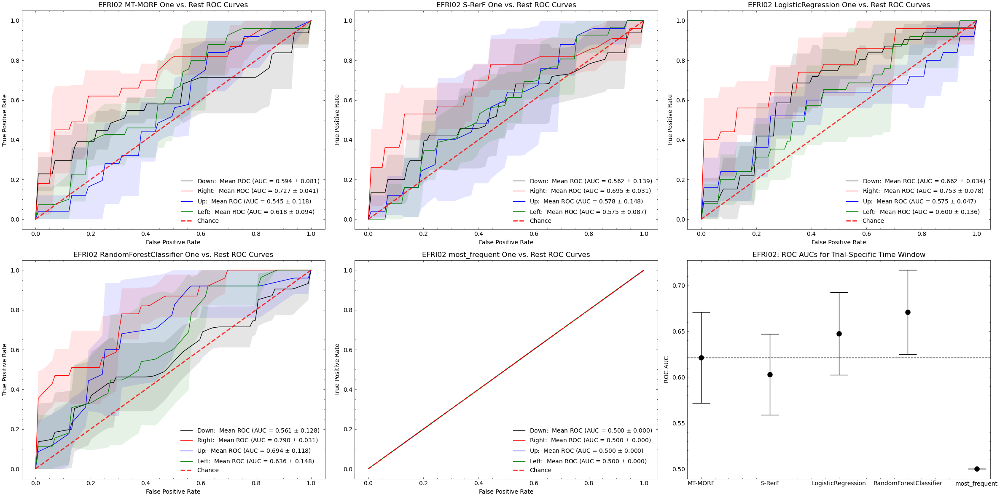

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri02/trial_specific_window/time_domain/efri02_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

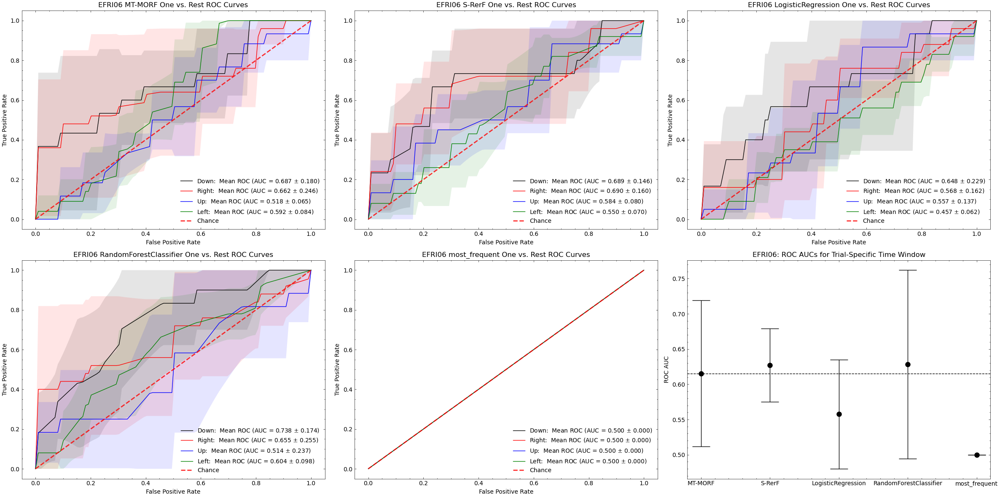

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri06/trial_specific_window/time_domain/efri06_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

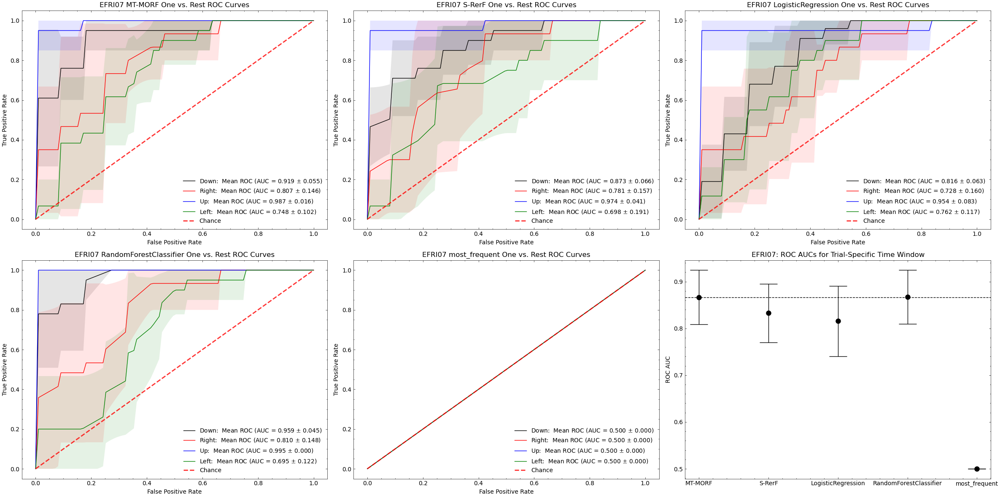

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri07/trial_specific_window/time_domain/efri07_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

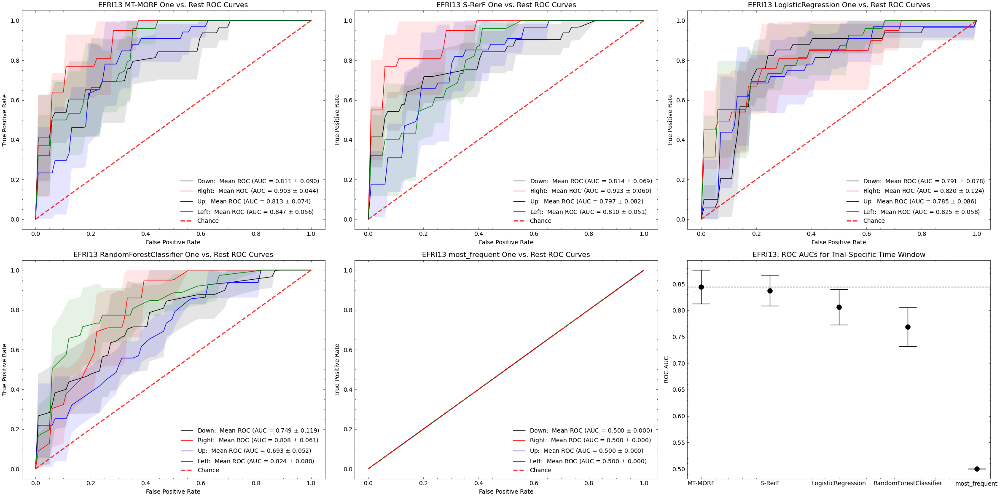

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri13/trial_specific_window/time_domain/efri13_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

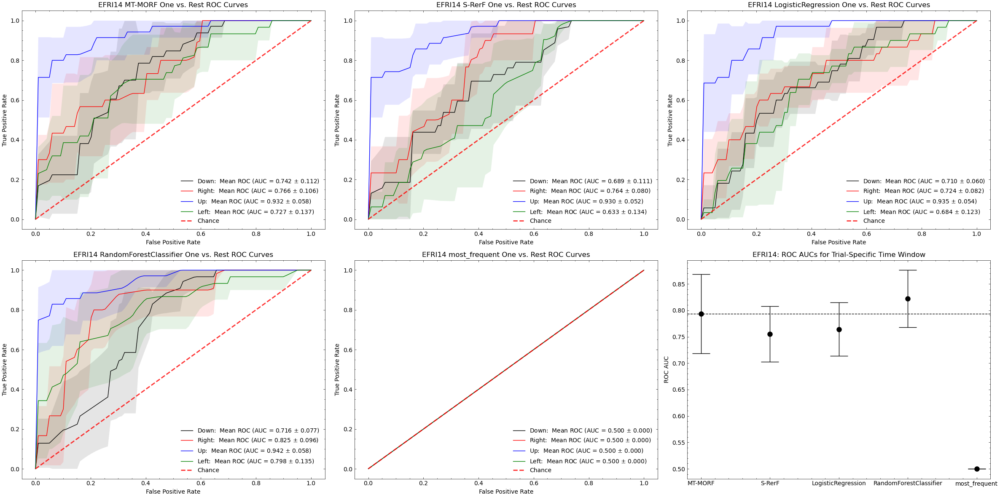

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri14/trial_specific_window/time_domain/efri14_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

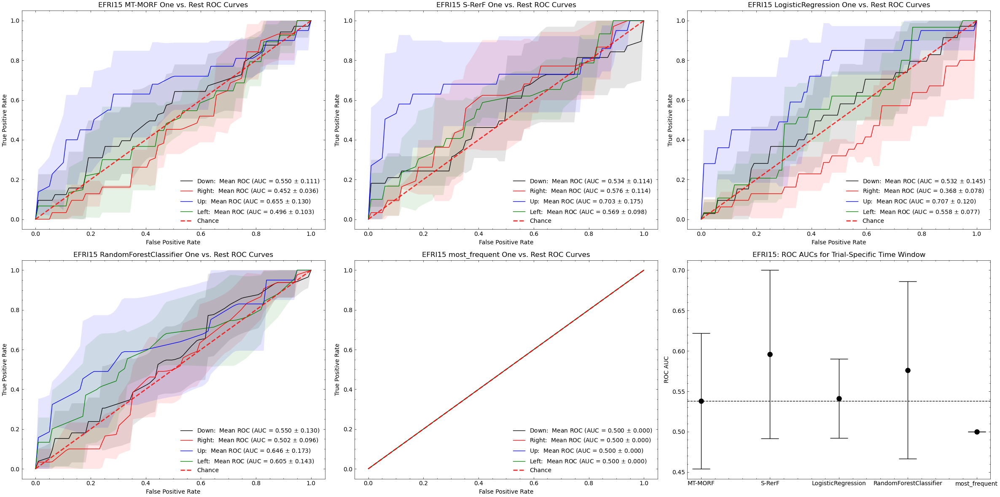

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri15/trial_specific_window/time_domain/efri15_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

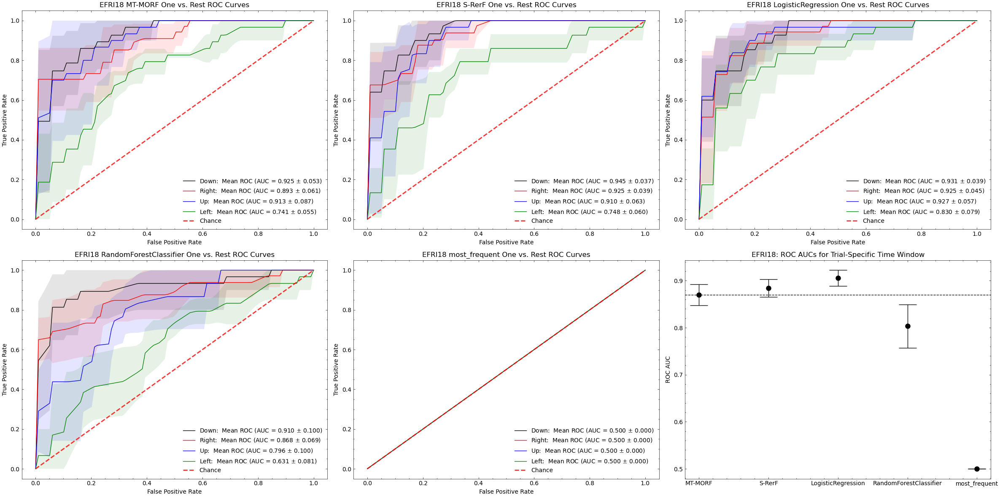

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri18/trial_specific_window/time_domain/efri18_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

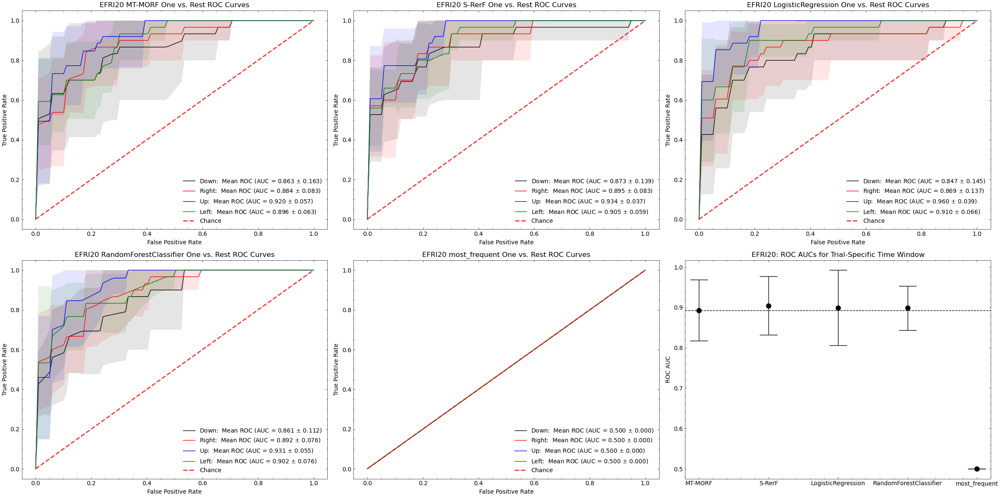

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri20/trial_specific_window/time_domain/efri20_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

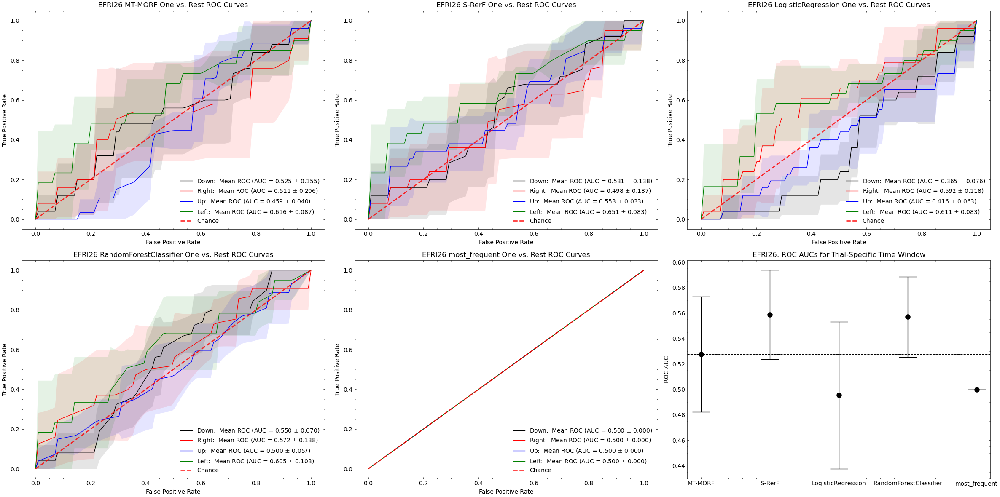

Figure saved at /Users/ChesterHuynh/Johns Hopkins/Adam Li - efri/derivatives/workstation_output/efri26/trial_specific_window/time_domain/efri26_trial_specific_time_window_rocs.png


<Figure size 432x288 with 0 Axes>

In [8]:
for subject, clf_scores in subject_clf_scores4.items():

    destination = results_path / subject / "trial_specific_window" / "time_domain"
    if not os.path.exists(destination):
        os.makedirs(destination)

    X, y = data4[subject]

    fig, axs = plt.subplots(nrows=2, ncols=3, dpi=100, figsize=(24, 12))
    axs = axs.flatten()
    for i, (clf_name, scores) in enumerate(clf_scores.items()):
        ax = axs[i]

        plot_roc_multiclass_cv(
            scores["test_predict_proba"],
            X,
            y,
            scores["test_inds"],
            ax=ax,
        )

        ax.set(
            xlabel="False Positive Rate",
            ylabel="True Positive Rate",
            xlim=[-0.05, 1.05],
            ylim=[-0.05, 1.05],
            title=f"{subject.upper()} {clf_name} One vs. Rest ROC Curves",
        )
        ax.legend(loc="lower right")
    
    plot_roc_aucs(clf_scores, ax=axs[-1])
    axs[-1].set(
        ylabel="ROC AUC",
        title=f"{subject.upper()}: ROC AUCs for Trial-Specific Time Window",
    )
    fig.tight_layout()

    plt.show()

    plt.savefig(destination / f"{subject}_trial_specific_time_window_rocs.png")
    plt.close(fig)
    print(f"Figure saved at {destination}/{subject}_trial_specific_time_window_rocs.png")

**Summary of Results (Trial-Specific, Time Domain)**
- Good (ROC AUC Mean-1SD >= 0.75): 07, 13, 18, 20
- Moderate (ROC AUC Mean-1SD >= 0.55): 02, 14
- Poor (ROC AUC Mean-1SD < 0.55): 06, 15, 26

**Quality of results (Patient-Specific, Freq Domain)**
- Both markedly non-trivial: efri07,  efri20,
- Both barely non-trivial: efri14, efri15, efri26
- One clf is trivial: efri02, efri13
- Both MT-MORF or S-ReRF is trivial: efri06, efri18

## Brain Anatomy Overlaps

In [160]:
channels = []
for subject in subjects:
    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".tsv",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    bids_path.update(suffix="channels")
    bads = _get_bad_chs(bids_path)
    
    tmp = _from_tsv(bids_path)
    tmp = [
        (name, anat, subject) 
        for (name, anat) in zip(tmp["name"], tmp["anat"]) 
        if name not in bads
    ]

    channels.extend(tmp)

channels = pd.DataFrame(channels, columns=["name", "anat", "subject"])
channels.head()
sorted_channels = channels.sort_values(["anat", "subject"])

In [161]:
groups = {
    "good (efri07, efri13, efri18, efri20)": ["efri07", "efri13", "efri18", "efri20"],
    "moderate (efri02, efri14)": ["efri02", "efri14"],
    "bad (efri06, efri15, efri26)": ["efri06", "efri15", "efri26"]
}

# determine common anatomy in all patients
for kind, group in groups.items():
    group_anat = None
    for subject in group:
        subject_anat = sorted_channels.anat[sorted_channels.subject == subject]
        if group_anat is None:
            group_anat = set(subject_anat)
        else:
            group_anat = group_anat & set(subject_anat)
    print(kind, group_anat)

good (efri07, efri13, efri18, efri20) {'FZ', 'PZ', 'CZ'}
moderate (efri02, efri14) {'cingulate cortex (posterior) L', 'angular gyrus L', 'hippocampus (anterior) R', 'middle temporal gyrus L', 'hippocampus (anterior) L', 'inferior temporal gyrus L', 'superior temporal gyrus (planum temporale) L', 'orbitofrontal cortex L', 'FZ', 'supramarginal gyrus L', 'PZ', 'hippocampus (posterior) L', 'CZ', 'intraparietal sulcus L', 'superior temporal gyrus (planum polare) L', 'precuneus L', 'fusiform gyrus L'}
bad (efri06, efri15, efri26) {'PZ', 'CZ', 'FZ'}


In [162]:
anatomy = []
for subject in subjects:
    path_identifiers = dict(
        subject=subject,
        session="efri",
        task="move",
        acquisition="seeg",
        run="01",
        suffix="ieeg",
        extension=".tsv",
        root=bids_root
    )
    bids_path = BIDSPath(**path_identifiers)
    bids_path.update(suffix="channels")
    bads = _get_bad_chs(bids_path)
    
    tmp = _from_tsv(bids_path)
    tmp = [
        (ch, anat, subject) 
        for (ch, anat) in zip(tmp["name"], tmp["anat"]) 
        if ch not in bads
    ]

    anatomy.extend(tmp)

anat_df = pd.DataFrame(anatomy, columns=["channel_name", "anat", "subject"])
anat_df

,channel_name,anat,subject
0,P9,angular gyrus R,efri02
1,P6,intraparietal sulcus R,efri02
2,P5,intraparietal sulcus R,efri02
3,P3,postcentral sulcus R,efri02
4,P1,precuneus R,efri02
...,...,...,...
761,O'2,straight gyrus L,efri26
762,O'1,straight gyrus L,efri26
763,REF1,FZ,efri26
764,REF2,CZ,efri26


In [163]:
# determine common anatomy in all patients
grouped_anatomy = dict()
for kind, group in groups.items():
    group_anat = None
    for subject in group:
        subject_rows = sorted_channels[sorted_channels.subject == subject]
        if group_anat is None:
            group_anat = subject_rows
        else:
            group_anat = group_anat.append(subject_rows)
    grouped_anatomy[kind] = group_anat
grouped_anatomy

{'good (efri07, efri13, efri18, efri20)':      name                                          anat subject
 225  REF2                                            CZ  efri07
 224  REF1                                            FZ  efri07
 226     E                                            PZ  efri07
 161    D9                               angular gyrus R  efri07
 162    D8                               angular gyrus R  efri07
 ..    ...                                           ...     ...
 619    C8  superior temporal gyrus (planum temporale) R  efri20
 585   X11                    superior temporal sulcus R  efri20
 586   X10                    superior temporal sulcus R  efri20
 620    C5                               temporal horn R  efri20
 633    F1                                   tentorium R  efri20
 
 [358 rows x 3 columns],
 'moderate (efri02, efri14)':      name             anat subject
 65   REF2               CZ  efri02
 64   REF1               FZ  efri02
 66      E     

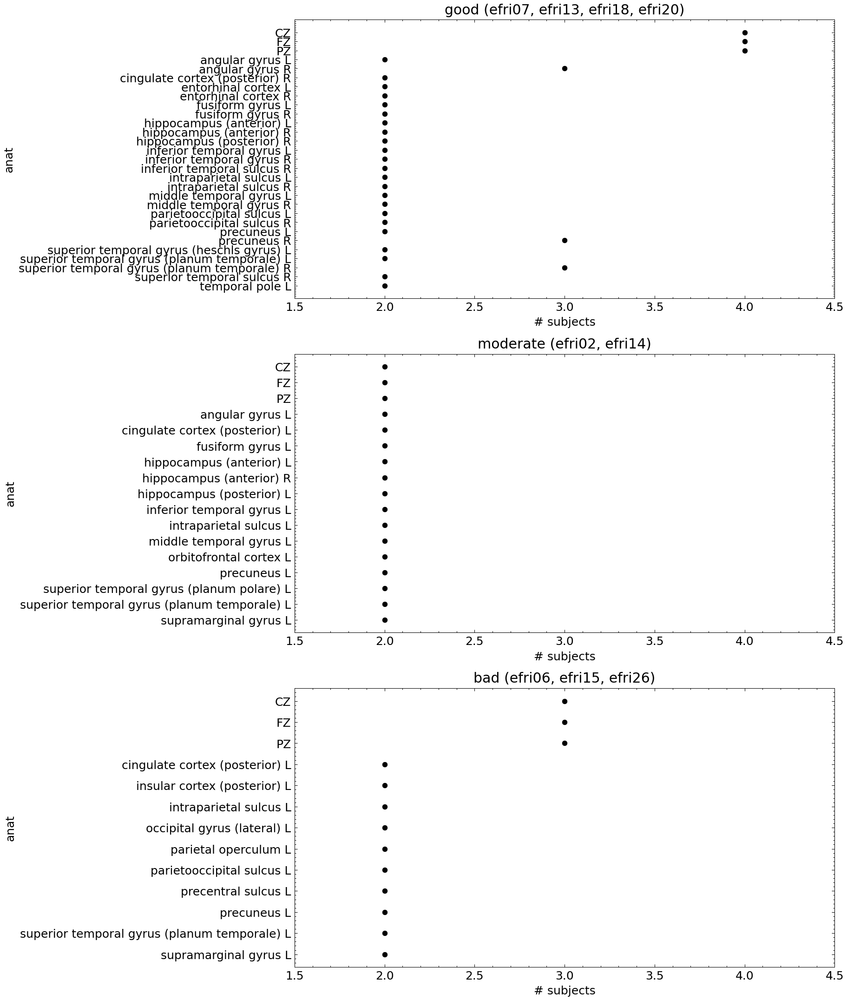

In [164]:
fig, axs = plt.subplots(dpi=150, nrows=3, figsize=(10, 18))
axs = axs.flatten()

for i, (kind, group_anat) in enumerate(grouped_anatomy.items()):
    unique_anat_count = group_anat.groupby('anat').nunique()
    data = unique_anat_count[unique_anat_count.subject > 1]
    sns.scatterplot(x=data.subject, y=data.index, ax=axs[i])
    axs[i].set(xlabel="# subjects", title=kind, xlim=[1.5, 4.5])

In [165]:
group_anat_sets = dict()
for kind, group_anat in grouped_anatomy.items():
    unique_anat_count = group_anat.groupby('anat').nunique()
    data = unique_anat_count[unique_anat_count.subject > 1]
    group_anat_sets[kind] = set(data.index)

In [166]:
group_anat_set_diffs = dict()
for kind, anat_set in group_anat_sets.items():
    rest = set()
    for kind2, anat_set2 in group_anat_sets.items():
        if kind == kind2:
            continue
        rest = rest | anat_set2
    group_anat_set_diffs[kind] = anat_set - rest

group_anat_set_diffs

{'good (efri07, efri13, efri18, efri20)': {'angular gyrus R',
  'cingulate cortex (posterior) R',
  'entorhinal cortex L',
  'entorhinal cortex R',
  'fusiform gyrus R',
  'hippocampus (posterior) R',
  'inferior temporal gyrus R',
  'inferior temporal sulcus R',
  'intraparietal sulcus R',
  'middle temporal gyrus R',
  'parietooccipital sulcus R',
  'precuneus R',
  'superior temporal gyrus (heschls gyrus) L',
  'superior temporal gyrus (planum temporale) R',
  'superior temporal sulcus R',
  'temporal pole L'},
 'moderate (efri02, efri14)': {'hippocampus (posterior) L',
  'orbitofrontal cortex L',
  'superior temporal gyrus (planum polare) L'},
 'bad (efri06, efri15, efri26)': {'insular cortex (posterior) L',
  'occipital gyrus (lateral) L',
  'parietal operculum L',
  'precentral sulcus L'}}

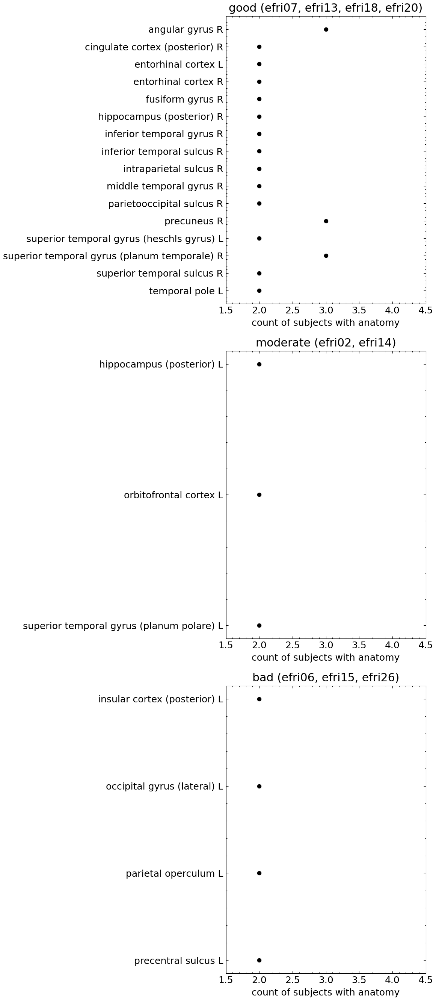

In [167]:
plt.rcParams.update({"font.size": 12})
fig, axs = plt.subplots(nrows=3, dpi=150, figsize=(8, 18))
axs = axs.flatten()

for i, (kind, group_anat) in enumerate(grouped_anatomy.items()):
    subset_anat = group_anat[group_anat.anat.isin(list(group_anat_set_diffs[kind]))]
    unique_anat_count = subset_anat.groupby('anat').nunique()
    data = unique_anat_count[unique_anat_count.subject > 1]
    sns.scatterplot(x=data.subject, y=data.index, ax=axs[i])
    axs[i].set(xlabel="count of subjects with anatomy", ylabel="", title=kind, xlim=[1.5, 4.5])
fig.tight_layout();

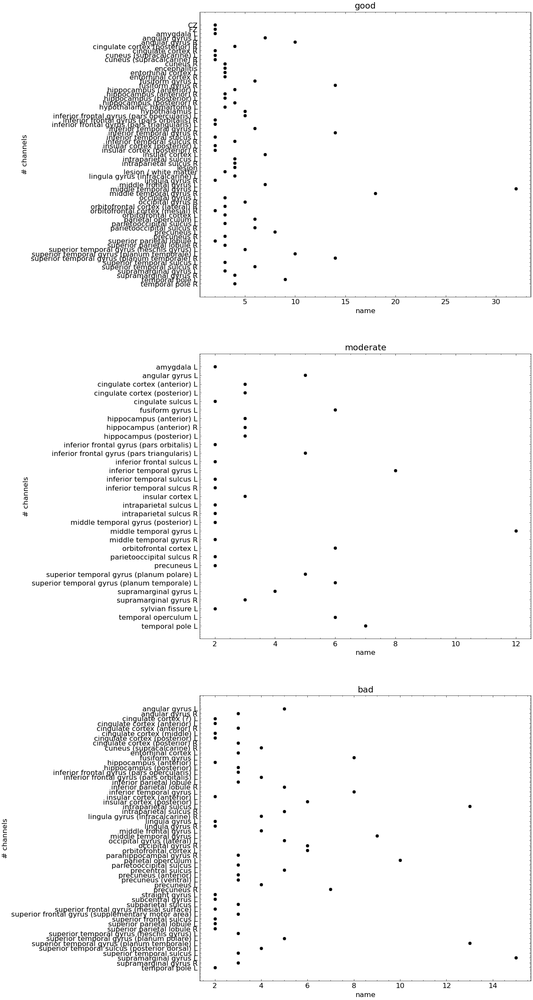

In [15]:
fig, axs = plt.subplots(dpi=100, nrows=3, figsize=(10, 30))
axs = axs.flatten()

for i, (kind, group_anat) in enumerate(grouped_anatomy.items()):
    unique_anat_count = group_anat.groupby('anat').nunique()
    data = unique_anat_count[unique_anat_count.name > 1]
    sns.scatterplot(x=data.name, y=data.index, ax=axs[i])
    axs[i].set(ylabel="# channels", title=kind)